<a href="https://colab.research.google.com/github/murilo-cunha/mlops-workshop-tmp/blob/main/MLOps_Tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#  <span style="color:orange">Binary Classification using DVC, Pycaret and MLFlow </span>

#IMPORTANT INSTRUCTIONS
Please make a copy of this notebook, upload it into your own google drive and [![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/googlecolab/colabtools/blob/master/notebooks/colab-github-demo.ipynb)




# 1 Tutorial Objective
Welcome to this tutorial on MLops. This tutorial will show you how to version your data using DVC, track your experiments using MLFlow and doing autoML using Pycaret. This tutorial is partly based on the [Binary Classification Tutorial Level Beginner - CLF101 tutorial](https://www.pycaret.org/tutorials/html/CLF101.html) and [Binary Classification Tutorial Level Intermediate - CLF102 tutorial](https://www.pycaret.org/tutorials/html/CLF102.htmland) from Pycaret.

There are other open source libraries available, when in need to build an MLOps pipeline, please consider carefully your own constraints and requirements to best choose the appropriate tools. 

The objective is not to build the best model possible, rather to demonstrate how to implement a simple MlOps pipeline with open source tooling. 

We use Colab for the ease of the demo, we do not advise to build your MLOps pipelines within a notebooks. The goal is to have a visual easy to follow tutorial to best understand the different steps of an MLOps pipeline.


![Maintainer](https://dataroots.io/maintained-rnd.svg)

## 1.1 Pre-Requisites
This tutorial is tested using Python 3.7.12.

In [ ]:
!python --version

Python 3.7.13


## 1.2 Installing packages

We need to install the right version of all the python packages. We first pipe them into a requirements file and then install these using *pip* 

In [ ]:
!printf 'pycaret \ndvc[gdrive] \npandas==1.3.5 \nPyYAML==5.1 \nxlrd==2.0.1 ' > requirements.txt

In [ ]:
!pip install -q -r requirements.txt

     |████████████████████████████████| 319 kB 5.1 MB/s 
     |████████████████████████████████| 400 kB 47.5 MB/s 
     |████████████████████████████████| 274 kB 46.6 MB/s 
     |████████████████████████████████| 96 kB 5.0 MB/s 
     |████████████████████████████████| 1.3 MB 33.1 MB/s 
     |████████████████████████████████| 86 kB 5.7 MB/s 
     |████████████████████████████████| 261 kB 51.2 MB/s 
     |████████████████████████████████| 16.5 MB 123 kB/s 
     |████████████████████████████████| 1.7 MB 37.1 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 6.8 MB 24.5 MB/s 
     |████████████████████████████████| 114 kB 38.5 MB/s 
     |████████████████████████████████| 2.0 MB 38.7 MB/s 
     |████████████████████████████████| 167 kB 51.6 MB/s 
     |████████████████████████████████| 56 kB 3.7 MB/s 
     |████████████████████

## 1.3 Enabling Google colab for Pycaret:
Since we are running this notebook on Google colab, run the following code at top of your notebook to display interactive visuals.<br/>


In [ ]:
from pycaret.utils import enable_colab 
enable_colab()

Colab mode enabled.


# 2 Dataset for the Tutorial

For this tutorial we will be using the same the dataset from UCI called *Default of Credit Card Clients* Dataset. In the next steps we will explore this dataset.


#### Dataset Acknowledgements:
Lichman, M. (2013). UCI Machine Learning Repository. Irvine, CA: University of California, School of Information and Computer Science.

The original dataset and data dictionary can be __[found here](https://archive.ics.uci.edu/ml/datasets/default+of+credit+card+clients)__ at the UCI Machine Learning Repository.

We'll go over the dataset in the next section and explain the data. 

# 3 Using **DVC** to version the data



## 3.1 What is **Data Version Control** (**DVC**)? 

**Data Version Control (DVC)** is a data versioning software that works on top of Git. Data versioning is enabled by replacing large files with small metafiles, which can be easily tracked by Git. These small metafiles point to the original large files, which are stored on-premise or on cloud storage. These files are thus decoupled from the code base.

DVC can also be used as an experiment management tool, but in this tutorial we focus on DVC as an data versioning tool. More information on DVC can be found [here](https://dvc.org/doc).

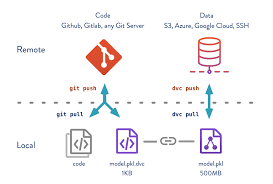

## 3.2 Getting and understanding the data 

We will first get the data from the UCI website and inspect the first rows using the Pandas library, then we will store the data in a csv file in a folder called data, on this machine (vm)

In [ ]:
import pandas as pd 
import os 

cwd = os.getcwd()

df = pd.read_excel('https://archive.ics.uci.edu/ml/machine-learning-databases/00350/default%20of%20credit%20card%20clients.xls', header=1, index_col=0)
print(df.head())

    LIMIT_BAL  SEX  EDUCATION  MARRIAGE  AGE  PAY_0  PAY_2  PAY_3  PAY_4  \
ID                                                                         
1       20000    2          2         1   24      2      2     -1     -1   
2      120000    2          2         2   26     -1      2      0      0   
3       90000    2          2         2   34      0      0      0      0   
4       50000    2          2         1   37      0      0      0      0   
5       50000    1          2         1   57     -1      0     -1      0   

    PAY_5  ...  BILL_AMT4  BILL_AMT5  BILL_AMT6  PAY_AMT1  PAY_AMT2  PAY_AMT3  \
ID         ...                                                                  
1      -2  ...          0          0          0         0       689         0   
2       0  ...       3272       3455       3261         0      1000      1000   
3       0  ...      14331      14948      15549      1518      1500      1000   
4       0  ...      28314      28959      29547      2000     

In [ ]:
data_dir = os.path.join(cwd, 'data')
if not os.path.exists(data_dir): 
  os.mkdir(data_dir)
  print("data directory created")
else:
  print("data directory already exists")
credit_file_name = 'credit_card_clients.csv'
df.to_csv(os.path.join(data_dir, credit_file_name))

data directory created


### Dataset features 

This dataset contains information on default payments, demographic factors, credit data, payment history, and billing statements of credit card clients in Taiwan from April 2005 to September 2005. There are 25 features. Short descriptions of each column are as follows:

- **ID**: ID of each client
- **LIMIT_BAL**: Amount of given credit in NT dollars (includes individual and family/supplementary credit)
- **SEX**: Gender (1=male, 2=female)
- **EDUCATION**: (1=graduate school, 2=university, 3=high school, 4=others, 5=unknown, 6=unknown)
- **MARRIAGE**: Marital status (1=married, 2=single, 3=others)
- **AGE**: Age in years
- **PAY_0 to PAY_6**: Repayment status by n months ago (PAY_0 = last month ... PAY_6 = 6 months ago) (Labels: -1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... 8=payment delay for eight months, 9=payment delay for nine months and above)
- **BILL_AMT1 to BILL_AMT6**: Amount of bill statement by n months ago ( BILL_AMT1 = last_month .. BILL_AMT6 = 6 months ago)
- **PAY_AMT1 to PAY_AMT6**: Amount of payment by n months ago ( BILL_AMT1 = last_month .. BILL_AMT6 = 6 months ago)
- **default**: Default payment (1=yes, 0=no) `Target Column`

## 3.3 Initialize DVC and track the raw data

We both initialize Git as well as DVC in the repo using the `init` command. You can see during this tutorial that commands of Git and DVC are very similar. Don't forget to configure the user email and user name for Git. You can do this by replace **you@example.com** and **Your Name** by your own email address and name. Files for DVC configuration are created and staged automatically, so we only need to commit these changes.

In [ ]:
!echo 'Initialize Git.'
!git init
!git config --global user.email "you@example.com"
!git config --global user.name "Your Name"

Initialize Git.
Initialized empty Git repository in /content/.git/


In [ ]:
!echo 'Initialize DVC.' 
!dvc init -f
!echo 'Make first commit.'
!git commit -m 'initialize repo'

Initialize DVC.
Initialized DVC repository.

You can now commit the changes to git.

+---------------------------------------------------------------------+
|                                                                     |
|        DVC has enabled anonymous aggregate usage analytics.         |
|     Read the analytics documentation (and how to opt-out) here:     |
|             <https://dvc.org/doc/user-guide/analytics>              |
|                                                                     |
+---------------------------------------------------------------------+

What's next?
------------
- Check out the documentation: <https://dvc.org/doc>
- Get help and share ideas: <https://dvc.org/chat>
- Star us on GitHub: <https://github.com/iterative/dvc>
Make first commit.
[master (root-commit) a574836] initialize repo
 3 files changed, 6 insertions(+)
 create mode 100644 .dvc/.gitignore
 create mode 100644 .dvc/config
 create mode 100644 .dvcignore


Next, we will configure the dvc **remote**. This is the place where DVC will store the large files, which can't be versioned using Git. For the sake of this example, we will use Google Drive as a remote. In practice, you would use a dedicated folder, either on prem or a cloud storage bucket. 

 For this 

1.  Make a MLOps directory in **your** Google drive 
2.  Within this directory make a *Data* directory (This *Data* directory will be used to store the data tracked by Git.)
3. Get the path of the MLOps/data directory: `gdrive://folder_id/path/to/folder`. 
The folder_id can be found in the URL of the google drive MLOps folder: (https://drive.google.com/drive/folders/folder_id) (when you navigating to the MLops folder in your Google drive). 
4. **Please make sure to edit 
the path to the Gdrive in the code block below.**




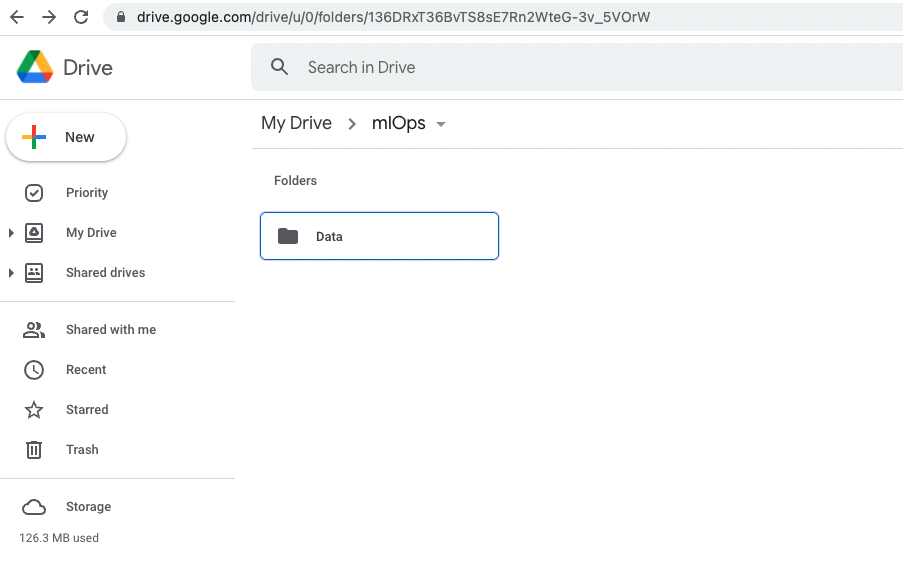


In [ ]:
!dvc remote add -d myremote #gdrive://136DRxT36BvTS8sE7Rn2WteG-3v_5VOrW/Data
!git commit .dvc/config -m 'configure remote storage'

Setting 'myremote' as a default remote.
[master 6f63d58] configure remote storage
 1 file changed, 4 insertions(+)



We can find this information about the remote configuration back in the configuration file of DVC (*.dvc/config*), we can commit this change. 

In [ ]:
! cat .dvc/config

[core]
    remote = myremote
['remote "myremote"']
    url = gdrive://136DRxT36BvTS8sE7Rn2WteG-3v_5VOrW/Data


There are two main steps for tracking data in DVC: first `add` the data and then `push` it to the remote. When we add the data to DVC a new file appears with the .dvc extension. This file contains information about our dataset, specifically it contains the md5 hash and the name of our dataset. Moreover the original datafile is also added to the *.gitignore* file automatically, so it won't be versioned using Git. The .dvc file will be tracked using Git.

In [ ]:
!dvc add data/credit_card_clients.csv 

⠙ Checking graph
Adding...:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
!
  0%|          |                                   0.00/? [00:00<?,        ?B/s]
                                                                                
Querying cache in /content/.dvc/cache:   0% 0.00/1.00 [00:00<?, ?file/s]
  0% 0.00/1.00 [00:00<?, ?file/s{'info': ''}]                           
                                             
Transferring:   0% 0/1 [00:00<?, ?file/s]
Transferring:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
                                                     
!
  0%|          |.UGt7uXLz6AZdgboPTJGiPj.tmp        0.00/? [00:00<?,        ?B/s]
.UGt7uXLz6AZdgboPTJGiPj.tmp:   0% 0.00/4.00 [00:00<?, ?B/s{'info': ''}]         
.UGt7uXLz6AZdgboPTJGiPj.tmp:   0% 0.00/4.00 [00:00<?, ?B/s{'info': ''}]
                                                                       
!
  0%|          |bf11c60a1b7b3298a1bb20d7f5ae05     0.00/? [00:00<?,        ?B/s]
bf11c60a1b7b3298a1bb20d7f5ae05:   0

In [ ]:
!cat data/credit_card_clients.csv.dvc

outs:
- md5: b4bf11c60a1b7b3298a1bb20d7f5ae05
  size: 2867208
  path: credit_card_clients.csv


In [ ]:
!cat data/.gitignore 

/credit_card_clients.csv


We can commit all our changes to Git and also tag this particular commit, so we can find the data easier back later on. 

In [ ]:
! git status

On branch master
Untracked files:
  (use "git add <file>..." to include in what will be committed)

	.config/
	data/
	requirements.txt
	sample_data/

nothing added to commit but untracked files present (use "git add" to track)


In [ ]:
!git add data/.gitignore data/credit_card_clients.csv.dvc
!git commit -m 'data: track'
!git tag -a 'v1' -m 'raw data'

[master ded80c7] data: track
 2 files changed, 5 insertions(+)
 create mode 100644 data/.gitignore
 create mode 100644 data/credit_card_clients.csv.dvc


Next, push the data to the Google drive. The first time we push or pull the data from the remote we need to authenticate ourselves. First click on the link, then log in with your Google account which we just used to create the MLops folder in Google Drive. Grant DVC access and paste the verification link in the code block. 

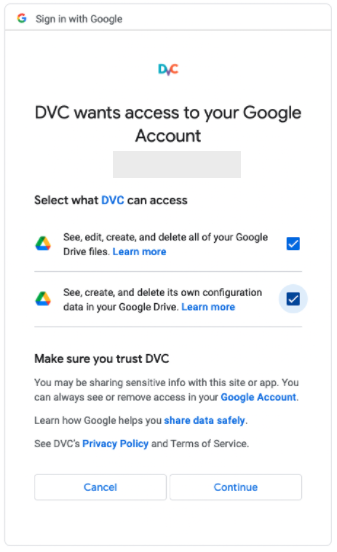

In [ ]:
!dvc push 

  0% 0/1 [00:00<?, ?file/s{'info': ''}]Go to the following link in your browser:

    https://accounts.google.com/o/oauth2/auth?client_id=710796635688-iivsgbgsb6uv1fap6635dhvuei09o66c.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.appdata&access_type=offline&response_type=code&approval_prompt=force

Enter verification code: 4/1AX4XfWhyAUxjpJrAmMj4sodWSpHFsmCXK3uJ6a3ST5k8myernCRGMDPGhhQ
Authentication successful.
Transferring:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
!
  0%|          |bf11c60a1b7b3298a1bb20d7f5ae05     0.00/? [00:00<?,        ?B/s]
bf11c60a1b7b3298a1bb20d7f5ae05:   0% 0.00/2.73M [00:00<?, ?B/s{'info': ''}]     
  0% 8.00k/2.73M [00:01<10:54, 4.37kB/s{'info': ''}]                       
1 file pushed


Now we can remove the data which we have stored locally with the commands in the code block below. **Refresh the folder structure of Google Colab and verify** that the *credit_card_clients.csv* file is not present anymore under the data directory. You might need to refresh the directory structure.

In [ ]:
!rm -rf data/credit_card_clients.csv
!rm -rf .dvc/cache

Retrieving the tracked data is very easy and can be done in one command.

In [ ]:
!dvc pull

Transferring:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
!
  0%|          |bf11c60a1b7b3298a1bb20d7f5ae05     0.00/? [00:00<?,        ?B/s]
bf11c60a1b7b3298a1bb20d7f5ae05:   0% 0.00/2.73M [00:00<?, ?B/s{'info': ''}]     
100% 2.73M/2.73M [00:02<00:00, 1.21MB/s{'info': ''}]                       
Checkout:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
!
  0%|          |.BAkxcfcjgTuZjDQHyimTqT.tmp        0.00/? [00:00<?,        ?B/s]
.BAkxcfcjgTuZjDQHyimTqT.tmp:   0% 0.00/4.00 [00:00<?, ?B/s{'info': ''}]         
.BAkxcfcjgTuZjDQHyimTqT.tmp:   0% 0.00/4.00 [00:00<?, ?B/s{'info': ''}]
                                                                       
!
  0%|          |bf11c60a1b7b3298a1bb20d7f5ae05     0.00/? [00:00<?,        ?B/s]
bf11c60a1b7b3298a1bb20d7f5ae05:   0% 0.00/2.73M [00:00<?, ?B/s{'info': ''}]     
bf11c60a1b7b3298a1bb20d7f5ae05:   0% 0.00/2.73M [00:00<?, ?B/s{'info': ''}]
A       data/credit_card_clients.csv
1 file added and 1 file fetched


## 3.3 Modify the data and track it.

Let's modify the data to be able to show the capabilities of DVC better. We will remove the last 10 lines of the data and save it.

In [ ]:
file_path = os.path.join(data_dir, credit_file_name)
df = pd.read_csv(file_path, index_col=0)
print('Old shape:', df.shape)
df.drop(df.tail(10).index,inplace=True)
print('New shape:', df.shape)
df.to_csv(file_path)

Old shape: (30000, 24)
New shape: (29990, 24)


To track the modified data we will almost repeat the previous steps: 
1.   Add the data to dvc.
2.   Add the .dvc of the data to git.
3.   Commit our changes.
4.   Tag the commit.
5.   Push the data to the remote storage. 



In [ ]:
!dvc add data/credit_card_clients.csv

⠋ Checking graph
Adding...:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
!
  0%|          |                                   0.00/? [00:00<?,        ?B/s]
                                                                                
Querying cache in /content/.dvc/cache:   0% 0.00/1.00 [00:00<?, ?file/s]
  0% 0.00/1.00 [00:00<?, ?file/s{'info': ''}]                           
                                             
Transferring:   0% 0/1 [00:00<?, ?file/s]
Transferring:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
                                                     
!
  0%|          |.R3NEiREaKsNagbaroBXDzd.tmp        0.00/? [00:00<?,        ?B/s]
.R3NEiREaKsNagbaroBXDzd.tmp:   0% 0.00/4.00 [00:00<?, ?B/s{'info': ''}]         
.R3NEiREaKsNagbaroBXDzd.tmp:   0% 0.00/4.00 [00:00<?, ?B/s{'info': ''}]
                                                                       
!
  0%|          |5dacdf6eb7374225a50bfe87f292ab     0.00/? [00:00<?,        ?B/s]
5dacdf6eb7374225a50bfe87f292ab:   0

In [ ]:
!git add data/credit_card_clients.csv.dvc
!git commit -m 'data:remove 10 rows'
!git tag -a 'v2' -m 'removed 10 rows'

[master 2bfe505] data:remove 10 rows
 1 file changed, 2 insertions(+), 2 deletions(-)


In [ ]:
!dvc push

Transferring:   0% 0/1 [00:00<?, ?file/s{'info': ''}]
!
  0%|          |5dacdf6eb7374225a50bfe87f292ab     0.00/? [00:00<?,        ?B/s]
5dacdf6eb7374225a50bfe87f292ab:   0% 0.00/2.73M [00:00<?, ?B/s{'info': ''}]     
  0% 8.00k/2.73M [00:02<12:20, 3.86kB/s{'info': ''}]                       
1 file pushed


We remove again the data which is residing on the Collab machine.

In [ ]:
!rm -rf data/credit_card_clients.csv
!rm -rf .dvc/cache

The git log shows that we can very easily track the changes made to our data, moreover we can also see who made the changes. 

In [ ]:
!git log

commit 2bfe505dd6e8a83a25265a57ed2bf3ed13df6c61 (HEAD -> master, tag: v2)
Author: Your Name <you@example.com>
Date:   Wed Mar 30 14:37:32 2022 +0000

    data:remove 10 rows

commit ded80c7731cfc089fdfe65a3a089aedfae91e656 (tag: v1)
Author: Your Name <you@example.com>
Date:   Wed Mar 30 14:36:56 2022 +0000

    data: track

commit 6f63d585717218eb8b4dc673daeca50cc264de35
Author: Your Name <you@example.com>
Date:   Wed Mar 30 14:36:52 2022 +0000

    configure remote storage

commit a574836ff266adadb6118ca6053bbd2cdf3dca46
Author: Your Name <you@example.com>
Date:   Wed Mar 30 14:36:50 2022 +0000

    initialize repo


## 3.4 Get a particular version of the data

Retrieving the URL of the original files (v1) and original files itself can be done using the CLI or the DVC Python API. 

In [ ]:
from dvc.api import get_url, open

data_url=get_url(path='data/credit_card_clients.csv', rev='v1')

with open(path='data/credit_card_clients.csv', rev='v1', mode='r') as fd: 
  dataset = pd.read_csv(fd, index_col=0)
  print(dataset.shape)
  print(dataset.head())

(30000, 24)
    LIMIT_BAL  SEX  EDUCATION  MARRIAGE  AGE  PAY_0  PAY_2  PAY_3  PAY_4  \
ID                                                                         
1       20000    2          2         1   24      2      2     -1     -1   
2      120000    2          2         2   26     -1      2      0      0   
3       90000    2          2         2   34      0      0      0      0   
4       50000    2          2         1   37      0      0      0      0   
5       50000    1          2         1   57     -1      0     -1      0   

    PAY_5  ...  BILL_AMT4  BILL_AMT5  BILL_AMT6  PAY_AMT1  PAY_AMT2  PAY_AMT3  \
ID         ...                                                                  
1      -2  ...          0          0          0         0       689         0   
2       0  ...       3272       3455       3261         0      1000      1000   
3       0  ...      14331      14948      15549      1518      1500      1000   
4       0  ...      28314      28959      29547   

# 4 Setup of **Pycaret** and **MLFlow**

## 4.1 What is **Pycaret**?
 

PyCaret is an open-source, low-code machine learning library in Python that automates machine learning workflows. It is an end-to-end machine learning and model management tool that exponentially speeds up the experiment cycle and makes you more productive.
Compared with the other open-source machine learning libraries, PyCaret is an alternate low-code library that can be used to replace hundreds of lines of code with few lines only. This makes experiments exponentially fast and efficient. PyCaret is essentially a Python wrapper around several machine learning libraries and frameworks such as scikit-learn, XGBoost, LightGBM, CatBoost, spaCy, Optuna, Hyperopt, Ray, and a few more.

## 4.2 Brief overview of techniques covered in this tutorial


Before we get into the practical execution of some techniques, it is important to understand what these techniques are and when to use them. More often than not most of these techniques will help linear and parametric algorithms, however it is not suprising to also see performance gains in tree-based models. The below explanations are only brief and we recommend that you to do extra reading to dive deeper and get a more thorough understanding of these techniques.

- **Normalization:** Normalization / Scaling (often used interchangeably with standardization) is used to transform the actual values of numeric variables in a way that provides helpful properties for machine learning. Many algorithms such as Logistic Regression, Support Vector Machine, K Nearest Neighbors and Naive Bayes assume that all features are centered around zero and have variances that are at at the same level of order. If a particular feature in a dataset has a variance that is larger in order of magnitude than other features, the model may not understand all features correctly and could perform poorly. For instance, in the dataset we are using for this example the `AGE` feature ranges between 21 to 79 while other numeric features range from 10,000 to 1,000,000. __[Read more](https://sebastianraschka.com/Articles/2014_about_feature_scaling.html#z-score-standardization-or-min-max-scaling)__ <br/>
<br/>
- **Transformation:** While normalization transforms the range of data to remove the impact of magnitude in variance, transformation is a more radical technique as it changes the shape of the distribution so that transformed data can be represented by a normal or approximate normal distirbution. In general, you should transform the data if using algorithms that assume normality or a gaussian distribution. Examples of such models are Logistic Regression, Linear Discriminant Analysis (LDA) and Gaussian Naive Bayes. (Pro tip: any method with “Gaussian” in the name probably assumes normality.) __[Read more](https://en.wikipedia.org/wiki/Power_transform)__<br/>
<br/>
- **Ignore Low Variance:** Datasets can sometimes contain categorical features that have a single unique or small number of values across samples. This kind of features are not only non-informative and add no value but are also sometimes harmful for few algorithms. Imagine a feature with only one unique value or few dominant unique values accross samples, they can be removed from the dataset by using the ignore low variance feature in PyCaret. <br/>
<br/>
- **Multi-collinearity:** Multi-collinearity is a state of very high intercorrelations or inter-associations among the independent features in the dataset. It is a type of disturbance in the data that is not handled well by machine learning models (mostly linear algorithms). Multi-collinearity may reduce overall coefficient of the model and cause unpredictable variance. This will lead to overfitting where the model may do great on a known training set but will fail with an unknown testing set. __[Read more](https://towardsdatascience.com/multicollinearity-in-data-science-c5f6c0fe6edf)__<br/>
<br/>
- **Group Features:** Sometimes datasets may contain features that are related at a sample level. For example in the `credit` dataset there are features called `BILL_AMT1 .. BILL_AMT6` which are related in such a way that `BILL_AMT1` is the amount of the bill 1 month ago and `BILL_AMT6` is the amount of the bill 6 months ago. Such features can be used to extract additional features based on the statistical properties of the distribution such as mean, median, variance, standard deviation etc. <br/>
<br/>
- **Bin Numeric Variables:** Binning or discretization is the process of transforming numerical variables into categorical features. An example would be the Age variable which is a continious distribution of numeric values that can be discretized into intervals (10-20 years, 21-30 etc.). Binning may improve the accuracy of a predictive model by reducing the noise or non-linearity in the data. PyCaret automatically determines the number and size of bins using Sturges rule.  __[Read more](https://www.vosesoftware.com/riskwiki/Sturgesrule.php)__<br/>
<br/>




## 4.3 Making a test set

In order to demonstrate the `predict_model()` function on unseen data, a sample of rows has been withheld from the original dataset to be used for predictions. This should not be confused with a train/test split as this particular split is performed to simulate a real life scenario. Another way to think about this is that these records were not available at the time when the machine learning experiment was performed.

In [ ]:
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)

data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions ' + str(data_unseen.shape))

Data for Modeling: (28500, 24)
Unseen Data For Predictions (1500, 24)


## 4.4 Setting up Environment in **PyCaret**

The` setup()` function initializes the environment in pycaret and creates the transformation pipeline to prepare the data for modeling and deployment. `setup() `must be called before executing any other function in pycaret. It takes two mandatory parameters: a pandas dataframe and the name of the target column. Additional parameters are passed to perform pre-processing steps.

You may have noticed is the `log_experiment` and `experiment_name` parameter we have used within `setup`. This is to log all the modeling activity in this experiment. Pycaret logs experiments in the backend with **MLFlow**. **MLFlow is automatically set up using Pycaret.** We will go later on deeper into the functionality of MLFlow. 

When running the codeblock below, don't forget to press enter to confirm the feature types or edit the proposal. 

In [ ]:
from pycaret.classification import *
exp_clf102 = setup(data = data,
                   target = 'default payment next month',
                   session_id=123,
                   normalize = True, 
                   transformation = True, 
                   ignore_low_variance = True,
                   remove_multicollinearity = True,
                   multicollinearity_threshold = 0.95,
                   bin_numeric_features = ['LIMIT_BAL', 'AGE'],
                   group_features = [['BILL_AMT1', 'BILL_AMT2','BILL_AMT3',
                                      'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6'],
                                     ['PAY_AMT1','PAY_AMT2', 'PAY_AMT3',
                                      'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6']],
                   log_experiment = True,
                   experiment_name = 'credit1',
                   profile= True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Pre-processing choices 



Notice that when the `profile` parameter is to `True`, it displays a data profile for exploratory data analysis. Several pre-processing steps as discussed above will be performed in this experiment based on this analysis. Let's summarize how the profile has helped make critical pre-processing choices with the data.

- **Missing Values:** There are no missing values in the data. However, we still need imputers in our pipeline just in case the new unseen data has missing values (not applicable in this case). When you execute the `setup()` function, imputers are created and stored in the pipeline automatically. By default, it uses a mean imputer for numeric values and a constant imputer for categorical. This can be changed using the `numeric_imputation` and `categorical_imputation` parameters in `setup()`. <br/>
<br/>
- **Multicollinearity:** There are high correlations between `BILL_AMT1 ... BIL_AMT6` which introduces multicollinearity into the data. We will remove multi-collinearity by using the `remove_multicollinearity` and `multicollinearity_threshold` parameters in setup. <br/>
<br/>
- **Data Scale / Range:** Notice how the scale / range of numeric features are different. For example the `AGE` feature ranges from between 21 to 79 and `BILL_AMT1` ranges from -165,580 to 964,511. This may cause problems for algorithms that assume all features have variance within the same order. In this case, the order of magnitude for `BILL_AMT1` is widely different than `AGE`. We will deal with this problem by using the `normalize` parameter in setup. <br/>
<br/>
- **Distribution of Feature Space:** Numeric features are not normally distributed. Look at the distributions of `LIMIT_BAL`, `BILL_AMT1` and `PAY_AMT1 ... PAY_AMT6`. A few features are also highly skewed such as `PAY_AMT1`. This may cause problems for algorithms that assume normal or approximate normal distributions of the data. Examples include Logistic Regression, Linear Discriminant Analysis (LDA) and Naive Bayes.  We will deal with this problem by using the `transformation` parameter in setup. <br/>
<br/>
- **Group Features:** From the data description we know that certain features are related with each other such as `BILL_AMT1 ... BILL_AMT6` and `PAY_AMT1 ... PAY_AMT6`. We will use the `group_features` parameter in setup to extract statistical information from these features.  <br/>
<br/>
- **Bin Numeric Features:** When looking at the correlations between the numeric features and the target variable, we that `AGE` and `LIMIT_BAL` are weak. We will use the `bin_numeric_features` parameter to remove the noise from these variables which may help linear algorithms. <br/>

## 4.5 What is **MLflow**?



MLflow is an open source platform to manage the ML lifecycle, including experimentation, reproducibility, deployment, and a central model registry. MLflow currently offers four components:

- MLflow Tracking 
- MLFlow Projects 
- MLFLow Models 
- MLFlow Registry

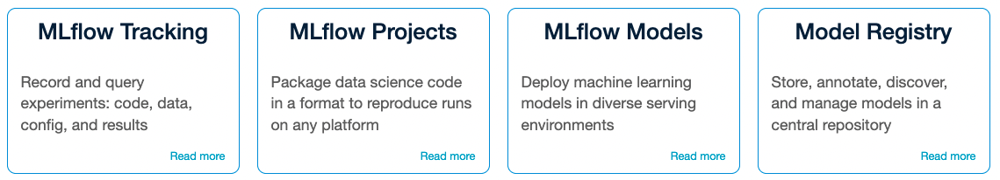

Here we will mainly focus on the Tracking component, which focuses on the reproducibility of machine learning experiments. There are two important concepts within MLflow: it has the concept of **Experiments** and **Runs**. A run can be seen a trial with a specific set of parameters. A run can track the artifacts, parameters, metrics and tags. Runs are grouped in experiments. 

## 4.6 Set experiment tag with **MLflow**. 

We will set the DVC URL as a tag for a certain experiment. So, we can later track back which version of the data was used for this experiment. 

In [ ]:
from mlflow.tracking import MlflowClient
import mlflow

client = MlflowClient()
experiment = client.get_experiment_by_name('credit1')
client.set_experiment_tag(experiment.experiment_id, 'dvc-url', data_url)

# 5 Comparing All Models using Pycaret

Comparing all models to evaluate performance is the recommended starting point for modeling once the `setup` is completed (unless you exactly know what kind of model you need, which is often not the case). This function trains all models in the model library and scores them using stratified cross validation for metric evaluation. The output prints a score grid that shows average Accuracy, AUC, Recall, Precision, F1, Kappa, and MCC accross the folds (10 by default) along with training times. Here we only use 5 fold cross validation to speed up the computation a bit. 

In [ ]:
top3 = compare_models(n_select = 3, fold = 5)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
gbc,Gradient Boosting Classifier,0.8209,0.7810,0.3546,0.6853,0.4673,0.3725,0.4018,9.954
ridge,Ridge Classifier,0.8205,0.0000,0.3539,0.6831,0.4662,0.3711,0.4002,0.096
lda,Linear Discriminant Analysis,0.8201,0.7769,0.3750,0.6673,0.4800,0.3814,0.4047,0.558
lightgbm,Light Gradient Boosting Machine,0.8187,0.7772,0.3677,0.6640,0.4732,0.3744,0.3984,0.868
ada,Ada Boost Classifier,0.8180,0.7767,0.3304,0.6847,0.4456,0.3523,0.3858,2.482
rf,Random Forest Classifier,0.8138,0.7637,0.3523,0.6461,0.4559,0.3552,0.3790,4.252
et,Extra Trees Classifier,0.8098,0.7503,0.3625,0.6212,0.4577,0.3519,0.3708,3.154
lr,Logistic Regression,0.7863,0.7043,0.1199,0.5906,0.1956,0.1324,0.1894,1.096
dummy,Dummy Classifier,0.7785,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.054
knn,K Neighbors Classifier,0.7582,0.6271,0.2200,0.4139,0.2873,0.1578,0.1693,1.262


Two simple words of code (not even a line) have trained and evaluated over multiple different models using cross validation. The score grid printed above highlights the highest performing metric for comparison purposes only. The grid by default is sorted using 'Accuracy' (highest to lowest) which can be changed by passing the sort parameter. For example `compare_models(sort = 'Recall')` will sort the grid by Recall instead of Accuracy. 

We did change the fold parameter from the default value of `10` to a different value by using the fold parameter. For example `compare_models(fold = 5)` will compare all models on 5 fold cross validation. Reducing the number of folds will improve the training time. By default, `compare_models` return the best performing model based on default sort order but can be used to return a list of top N models by using `n_select` parameter.

Notice that we have used `n_select` parameter within `compare_models`. You can use `n_select` parameter to return top N models. In this example `compare_models` has returned Top 3 models.

In [ ]:
type(top3)
print(top3)

[GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, normalize=False, random_state=123, solver='auto',
                tol=0.001), LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd'

Although, this is probably not the best metric for this type of problem, purposes of comparison, we will use the `AUC` score. 

# 6 Create a Model using **Pycaret**

`create_model` is the most granular function in PyCaret and is often the foundation behind most of the PyCaret functionalities. As the name suggests this function trains and evaluates a model using cross validation that can be set with fold parameter. The output prints a score grid that shows Accuracy, AUC, Recall, Precision, F1, Kappa and MCC by fold.

For the remaining part of this tutorial, we will work with the below models as our candidate models. **The selections are for illustration purposes only and do not necessarily mean they are the top performing or ideal for this type of data.**

There are 18 classifiers available in the model library of PyCaret. To see list of all classifiers either check the docstring or use models function to see the library. Some of the most commonly used classfiers are: 
- Decision Tree Classifier ('dt')
- K Neighbors Classifier ('knn')
- Random Forest Classifier ('rf')

## 6.1 Create Model (with CV)

Notice how passing the `round` parameter inside `create_model()` can round the evaluation metrics to 3 decimals and the `fold` parameter sets the cross validation to 5.

In [ ]:
rf = create_model('rf', fold=5, round = 3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.817,0.756,0.365,0.654,0.469,0.368,0.391
1,0.814,0.769,0.353,0.645,0.456,0.355,0.379
2,0.819,0.775,0.371,0.663,0.476,0.377,0.400
3,0.812,0.768,0.334,0.644,0.440,0.340,0.366
4,0.809,0.750,0.339,0.626,0.439,0.336,0.359
Mean,0.814,0.764,0.352,0.646,0.456,0.355,0.379
SD,0.004,0.009,0.015,0.012,0.015,0.016,0.015


# 7 Tune a Model using Pycaret

When a model is created using the `create_model()` function it uses the default hyperparameters to train the model. In order to **tune** hyperparameters, the `tune_model()` function is used. This function automatically tunes the hyperparameters of a model using `Random Grid Search` on a pre-defined search space. The output prints a score grid that shows Accuracy, AUC, Recall, Precision, F1, Kappa, and MCC by fold for the best model. To use the custom search grid, you can pass `custom_grid` parameter in the `tune_model` function.

The use of the `optimize` parameter in `tune_model()` can be thought of as an objective function. In `pycaret.classification` all hyperparameter tuning is set to optimize for `Accuracy` by default which can be changed using the `optimize` parameter. Here we will tune the model using 5 fold cross validation and set the number of iterations within random grid search to 3, to reduce training time. See the example below:

In [ ]:
tuned_rf = tune_model(rf, optimize = 'AUC', n_iter=3, fold=5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.7308,0.7630,0.6561,0.4296,0.5192,0.3434,0.3583
1,0.7353,0.7725,0.6674,0.4364,0.5277,0.3549,0.3703
2,0.7509,0.7755,0.6787,0.4580,0.5469,0.3840,0.3981
3,0.7368,0.7735,0.6663,0.4382,0.5287,0.3568,0.3719
4,0.7280,0.7542,0.6342,0.4236,0.5079,0.3301,0.3430
Mean,0.7364,0.7677,0.6606,0.4372,0.5261,0.3538,0.3683
SD,0.0079,0.0080,0.0150,0.0116,0.0128,0.0178,0.0181


The results of tuning Random Forest Classifiers would differ if we would use a different `optimize` param. In `tuned_rf` we optimized `AUC`. However, if we would set the `optimize` parameter to another parameter (e.g. `Recall`), it actually resulted in a better model in terms of `Recall`. `AUC` will then be compromised.

In [ ]:
plot_model(tuned_rf, plot = 'parameter')

,Parameters
bootstrap,False
ccp_alpha,0.0
class_weight,balanced_subsample
criterion,gini
max_depth,6
max_features,log2
max_leaf_nodes,None
max_samples,None
min_impurity_decrease,0.001
min_impurity_split,None


# 8 Model Calibration

When performing classification you often not only want to predict the class label (outcome such as 0 or 1), but also obtain the probability of the respective outcome which provides a level of confidence on the prediction. Some models can give you poor estimates of the class probabilities and some do not even support probability prediction. Well calibrated classifiers are probabilistic and provide outputs in the form of probabilities that can be directly interpreted as a confidence level. PyCaret allows you to calibrate the probabilities of a given model through the `calibrate_model()` function. See an example below:

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

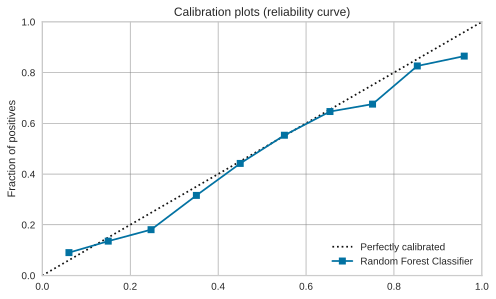

In [ ]:
plot_model(rf, plot='calibration')

In [ ]:
calibrated_rf = calibrate_model(rf, fold=5)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8173,0.7651,0.3439,0.6711,0.4547,0.3584,0.3874
1,0.8178,0.7711,0.3450,0.6733,0.4562,0.3602,0.3893
2,0.8180,0.7794,0.3450,0.6748,0.4566,0.3608,0.3901
3,0.8158,0.7756,0.3247,0.6753,0.4385,0.3441,0.3772
4,0.8127,0.7583,0.3284,0.6532,0.4371,0.3392,0.3681
Mean,0.8163,0.7699,0.3374,0.6695,0.4486,0.3525,0.3824
SD,0.0020,0.0075,0.0090,0.0083,0.0089,0.0090,0.0085


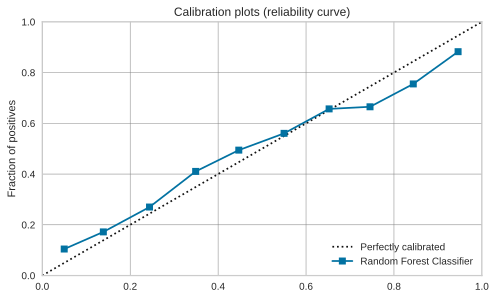

In [ ]:
plot_model(calibrated_rf, plot='calibration')

A perfectly calibrated classifier will follow the black dotted line in the above plots. Callibration is not needed for this particular model, as it hardly improves the performance. Above we used it for **educational purpose only**, to show the capabilities of Pycarets. 

By default, `calibrate_model()` uses the `sigmoid` method which corresponds to Platt's approach. The other available method is `isotonic` which is a non-parametric approach.

# 9 Plot a Model

Before model finalization, the `plot_model()` function can be used to analyze the performance across different aspects such as AUC, confusion_matrix, decision boundary etc. This function takes a trained model object and returns a plot based on the test / hold-out set.

There are 15 different plots available, please see the `plot_model()` docstring for the list of available plots.

## 9.1 AUC Plot

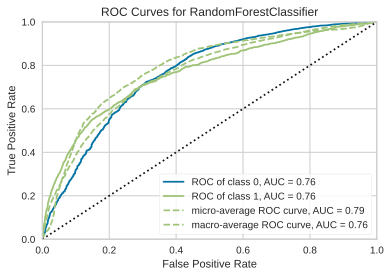

In [ ]:
plot_model(tuned_rf, plot = 'auc')

## 9.2 Feature Importance

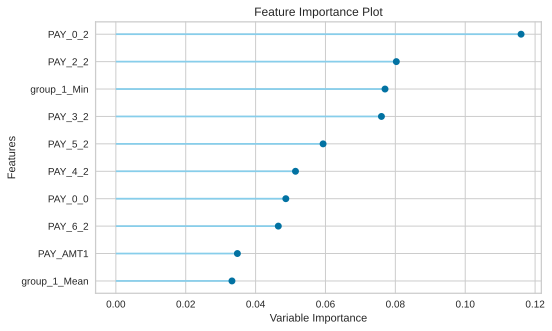

In [ ]:
plot_model(tuned_rf, plot = 'feature')

## 9.3 Confusion Matrix

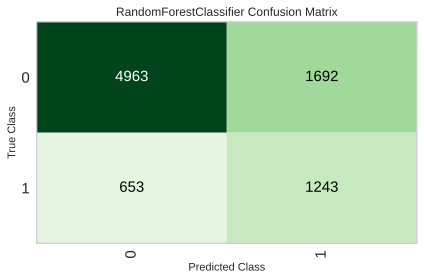

In [ ]:
plot_model(tuned_rf, plot = 'confusion_matrix')

# 10 Finalize Model for Deployment

Model finalization is the last step in the experiment. A normal machine learning workflow in PyCaret starts with` setup()`, followed by comparing all models using `compare_models()` and shortlisting a few candidate models (based on the metric of interest) to perform several modeling techniques such as hyperparameter tuning, ensembling, stacking etc. This workflow will eventually lead you to the best model for use in making predictions on new and unseen data. The `finalize_model()` function fits the model onto the complete dataset including the test/hold-out sample (30% in this case).

In [ ]:
final_rf = finalize_model(tuned_rf)
print(final_rf)

RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=6, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.001,
                       min_impurity_split=None, min_samples_leaf=6,
                       min_samples_split=9, min_weight_fraction_leaf=0.0,
                       n_estimators=190, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False)


The `predict_model()` function is also used to predict on the unseen dataset. The only difference above is that this time we will pass the data_unseen parameter. `data_unseen` is the variable created at the beginning of the tutorial and contains 5% (1200 samples) of the original dataset which was never exposed to PyCaret. (see section 5 for explanation)

In [ ]:
unseen_predictions = predict_model(final_rf, data=data_unseen)
unseen_predictions.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month,Label,Score
0,50000,1,1,2,37,0,0,0,0,0,...,20024,2500,1815,657,1000,1000,800,0,0,0.5900
1,280000,1,1,2,31,-1,-1,2,-1,0,...,9477,9075,0,9976,8000,9525,781,0,0,0.5293
2,180000,2,2,1,34,0,0,0,0,0,...,129918,8083,7296,5253,4814,4816,3800,0,0,0.6651
3,200000,2,2,1,32,-1,-1,-1,-1,2,...,3151,5818,15,9102,17,3165,1395,0,0,0.5375
4,50000,2,3,2,22,0,0,0,0,0,...,24094,1767,1362,1002,840,995,904,1,0,0.5853


In [ ]:
from pycaret.utils import check_metric
check_metric(unseen_predictions['default payment next month'], unseen_predictions['Label'], metric = 'AUC')

0.6996

# 11 Experiment Logging using **MLflow**

PyCaret >= 2.0 embeds MLflow Tracking component as a backend API and UI for logging parameters, code versions, metrics, and output files when running your machine learning code and for later visualizing the results. To log your experiments in pycaret simply use `log_experiment` and `experiment_name` parameter in the `setup` function, as we did in this example.

If you run your notebook locally you can start the UI on `https://localhost:5000`. You can then simply initiate the MLFlow server from command line or from notebook using: 
`
!mlflow ui
`.

However, we need a little work around using ngrok to make it work using Google Colab. Run the code block below, click on the link and sign up for a ngrok account. Then click on **Install Your Authtoken**. Copy and paste your auth token to the `AUTH_TOKEN`. variable and run the code block again and click on the link, the Mlflow UI should appear now. 

In [ ]:
# create remote tunnel using ngrok.com to allow local port access
# borrowed from https://colab.research.google.com/github/alfozan/MLflow-GBRT-demo/blob/master/MLflow-GBRT-demo.ipynb#scrollTo=4h3bKHMYUIG6
!pip install pyngrok --quiet
from pyngrok import ngrok

get_ipython().system_raw("mlflow server -h 0.0.0.0 -p 5000 --backend-store-uri $PWD/mlruns/ &")
ngrok.kill()
AUTH_TOKEN=""
ngrok.set_auth_token(AUTH_TOKEN)
ngrok_tunnel = ngrok.connect(addr="5000", proto="http", bind_tls=True)
print("MLflow Tracking UI:", ngrok_tunnel.public_url)

     |████████████████████████████████| 745 kB 5.5 MB/s 
MLflow Tracking UI: https://e612-34-136-17-219.ngrok.io


## Example of UI

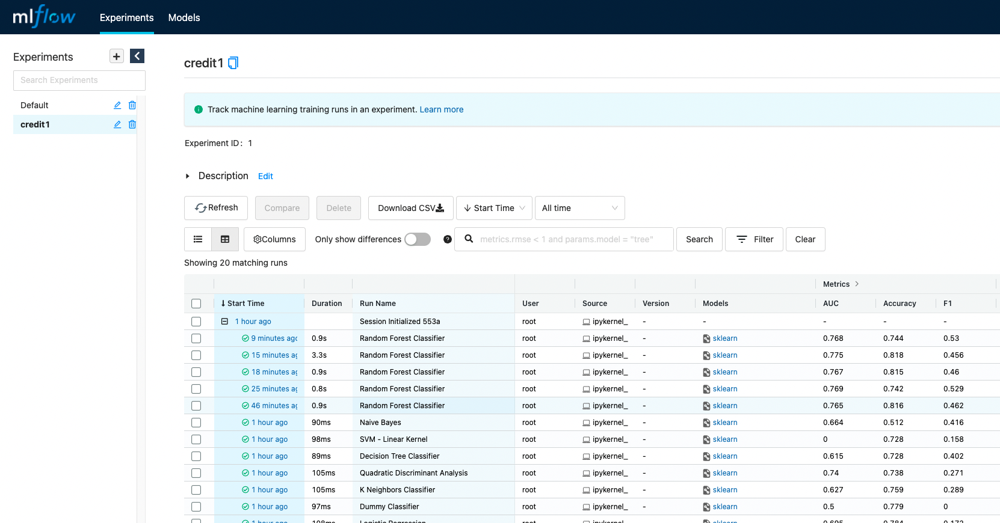

# 12 Batch Prediction

Now we will perform a batch prediction. Get the model path using the MLflow UI. Click on a run and check the model link .

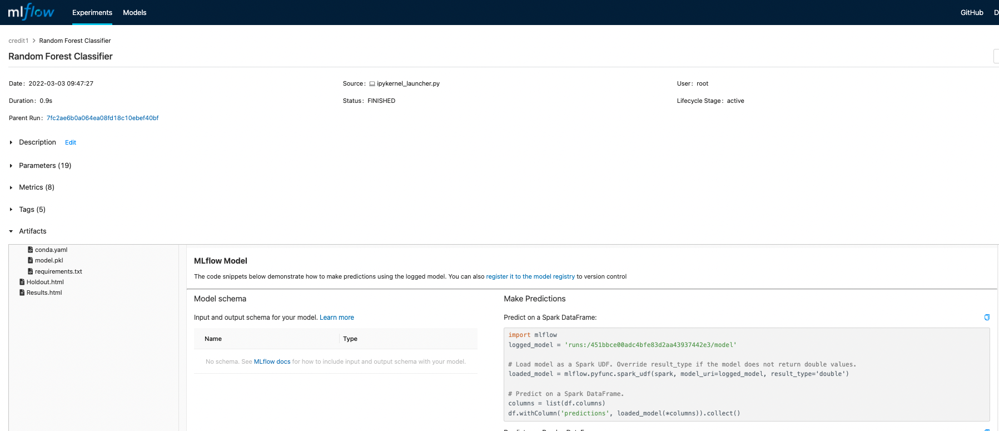

**Change the model URI** in the code blocks below:

In [ ]:
import mlflow

# Check your desired model id from mlflow
logged_model = 'runs:/d8dbe97b709f4e64805f7cbc20ede6c7/model'

# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)

# Predict on a Pandas DataFrame.
import pandas as pd
loaded_model.predict(pd.DataFrame(data_unseen))

array([0, 0, 0, ..., 0, 0, 0])

# 13 Serving Model Via an API

Next we will serve the model. To get an example input for the served model we need to use the `log_model` function to log a sklearn model using **MLflow**. We need to do this as **Pycaret** does not have the option to save an example for now. The example can be found under `mlruns/<MODEL_FOLDER>/artifacts/finalized_model/input_example.json`.

In [ ]:
import mlflow.sklearn

mlflow.sklearn.log_model(final_rf, 'finalized_model', input_example=data_unseen.iloc[0:1])

2022/03/08 09:51:05 WARNING mlflow.utils.environment: Encountered an unexpected error while inferring pip requirements (model URI: /tmp/tmpohh8xyg5/model/model.pkl, flavor: sklearn), fall back to return ['scikit-learn==0.23.2', 'cloudpickle==1.3.0']. Set logging level to DEBUG to see the full traceback.


ModelInfo(artifact_path='finalized_model', flavors={'python_function': {'model_path': 'model.pkl', 'loader_module': 'mlflow.sklearn', 'python_version': '3.7.12', 'env': 'conda.yaml'}, 'sklearn': {'pickled_model': 'model.pkl', 'sklearn_version': '0.23.2', 'serialization_format': 'cloudpickle'}}, model_uri='runs:/ed221d0cdda040688bba147f2bbf5eb9/finalized_model', model_uuid='b52597612b684a5486c4c6dff378e99e', run_id='ed221d0cdda040688bba147f2bbf5eb9', saved_input_example_info={'artifact_path': 'input_example.json', 'type': 'dataframe', 'pandas_orient': 'split'}, signature_dict=None, utc_time_created='2022-03-08 09:51:03.649333')

Now we will serve this model. For this we will use ngrok too. Ngrok allows you to expose a web server running on your machine to the internet. **Do not forget** to change the model URI in the code block below. 

In [ ]:
from pyngrok import ngrok

ngrok.kill()
ngrok.set_auth_token(AUTH_TOKEN)
ngrok_tunnel = ngrok.connect(addr="1234", proto="http", bind_tls=True)
print("Server URL:", ngrok_tunnel.public_url)

!mlflow models serve -m 'runs:/d8dbe97b709f4e64805f7cbc20ede6c7/model' -p 1234 -h 0.0.0.0 --no-conda

Server URL: https://afc6-35-225-236-92.ngrok.io
2022/03/08 09:53:22 INFO mlflow.models.cli: Selected backend for flavor 'python_function'
2022/03/08 09:53:22 INFO mlflow.pyfunc.backend: === Running command 'gunicorn --timeout=60 -b 0.0.0.0:1234 -w 1 ${GUNICORN_CMD_ARGS} -- mlflow.pyfunc.scoring_server.wsgi:app'
[2022-03-08 09:53:22 +0000] [3268] [INFO] Starting gunicorn 20.1.0
[2022-03-08 09:53:22 +0000] [3268] [INFO] Listening at: http://0.0.0.0:1234 (3268)
[2022-03-08 09:53:22 +0000] [3268] [INFO] Using worker: sync
[2022-03-08 09:53:22 +0000] [3271] [INFO] Booting worker with pid: 3271
/usr/local/lib/python3.7/dist-packages/distributed/config.py:20: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  defaults = yaml.load(f)
/usr/local/lib/python3.7/dist-packages/pycaret/internal/preprocess.py:1721: FutureWarning: The default value of regex will change from True to False in

## 13.1 Doing Predictions

Now you can open a new notebook under the files tab and run the line in the command below to make an inference on the model which is being served. Change `server_URL` by the server URL outputted byt the ngrok above. An example input to get an prediction on can be retrieved from `mlruns/<MODEL_FOLDER>/artifacts/model/input_example.json`.

In [ ]:
#!curl https://server_URL/invocations -H 'Content-Type: application/json' -d '{"columns": ["LIMIT_BAL", "SEX", "EDUCATION", "MARRIAGE", "AGE", "PAY_0", "PAY_2", "PAY_3", "PAY_4", "PAY_5", "PAY_6", "BILL_AMT1", "BILL_AMT2", "BILL_AMT3", "BILL_AMT4", "BILL_AMT5", "BILL_AMT6", "PAY_AMT1", "PAY_AMT2", "PAY_AMT3", "PAY_AMT4", "PAY_AMT5", "PAY_AMT6", "default payment next month"], "data": [[50000, 1, 1, 2, 37, 0, 0, 0, 0, 0, 0, 64400, 57069, 57608, 19394, 19619, 20024, 2500, 1815, 657, 1000, 1000, 800, 0]]}'

In [ ]:
# data_unseen.head(1).to_numpy()